# Age Estimation from Speech: A Regression Problem

##### **Goals and Objectives**:
-  The primary goal of this project is to design and implement a data science pipeline for predicting the age of a speaker based on their spoken sentences. The system will leverage acoustic features extracted from speech, along with the set of acoustic and linguistic features, to produce accurate age estimation

- Evaluate the model's performance by Root Mean Squared Error metric


##### **Data Requirements**

- Utilize data from development.csv and possibly extract additional features from audio samples







### **Import Libraries**

In [917]:
#Data manipulation and analysis
import pandas as pd
import numpy as np
import ast


# Data visualization
import matplotlib.pyplot as plt

# Machine learning 
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import root_mean_squared_error
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.linear_model import Ridge
from sklearn.model_selection import GridSearchCV


# Feature selection
from sklearn.decomposition import PCA
from sklearn.feature_selection import RFECV


# Feature extraction
import librosa
from librosa import feature


from os import listdir

## Audio Feature Extracting

##### In this project, we will use Librosa to extract various audio features that are essential for speech processing:

 - **Zero-crossing rate (ZCR)**: Measures the rate at which the signal changes sign, which can indicate the signal’s noisiness or smoothness

 - **Spectral centroid**: Represents the "center of mass" of the spectrum, often associated with the perceived brightness of the sound
 - **Spectral bandwidth**: Reflects the width of the spectral distribution
 - **Spectral rolloff**: Indicates the frequency below which a certain percentage of the total spectral energy lies
 - **Spectral contrast**: Captures the difference in amplitude between peaks and valleys in the sound spectrum
 - **Tonnetz**: Captures harmonic relations and tonality, which can be useful for speech analysis
 - **Tempogram**: Relates to the rhythm and tempo of the audio, highlighting periodicity and patterns in the signal
 - **Chroma features (chroma_stft and chroma_cens)**: Represent the energy distribution of pitch classes, useful for identifying harmonic content.
 - **Mel Frequency Cepstral Coefficients (MFCC)**: Crucial for distinguishing and analyzing the unique characteristics of speech.


##### We will extract the mean, maximum, minimum values, and their standard deviations for all of these features. For certain features, such as Zero-Crossing Rate (ZCR) and Spectral Centroid, the mean values are already included in the development.csv file. These extracted features, along with the ones provided in the dataset, will improve the performance of our model in estimating the speaker’s age.



### **Loading samples**

In [918]:
def load_audio_samples(file_path):
    """
    Load audio samples from a given directory.
    
    :param file_path: Directory path containing audio files
    :return: List of loaded audio samples
    
    """
    
    files = sorted([f for f in listdir(file_path)], key = lambda x: int(x.split(".")[0])) #listdir does not guarante that everything will be sorted in regular order
    audio_samples = [(librosa.load(f"{file_path}/{file}")) for file in files]
    return audio_samples

In [1030]:
root = "Dataset/DSL_Winter_Project_2025"

In [741]:
audio_dev_samples = load_audio_samples(file_path=f"{root}/audios_development")
audio_ev_samples = load_audio_samples(file_path=f"{root}/audios_evaluation")

### **Extracting additional features**

-  MFCC will be extracted separately to ensure simplicity and clarity

In [920]:
def get_additional_features(audio_samples):
    """
    Extracts additional features (ZCR, chroma, spectral, etc.) from audio samples 
    and returns a DataFrame with statistics (mean, std, min, max) for each feature.

    :param audio_samples: List of audio samples
    :return: DataFrame with extracted features and statistics
    
    """
    
    audio_features = [
        [
            feature.zero_crossing_rate(y=audio[0]),
            feature.chroma_cens(y=audio[0], sr=audio[1]),
            feature.spectral_centroid(y=audio[0], sr=audio[1]),
            feature.spectral_bandwidth(y=audio[0], sr=audio[1]),
            feature.spectral_rolloff(y=audio[0], sr=audio[1]),
            feature.spectral_contrast(y=audio[0], sr=audio[1]),
            feature.tonnetz(y=audio[0], sr=audio[1]),
            feature.tempogram(y=audio[0], sr=audio[1]),
            feature.chroma_stft(y=audio[0], sr=audio[1]),
        ]
        
        for audio in audio_samples ] # Process each audio sample
    
    audios_reduced_fetures = []
    
    for audio in audio_features:
        comp_features = np.array([np.array([np.mean(feature), np.std(feature), np.min(feature), np.max(feature)]) for feature in audio])
        audios_reduced_fetures.append(comp_features)

    final_results_matrix = [obj.flatten() for obj in audios_reduced_fetures]
    
    
    features = [
        "zcr",
        "chroma_sens",
        "spectral_centroid",
        "spectral_bandwidth",
        "spectral_rolloff",
        "spectral_contrast",
        "tonnetz",
        "tempogram",
        "chroma_stft"
    ]

    columns_ad = [f"{stat}_{feat}" for feat in features for stat in ['mean', 'std', 'min', 'max']]

    df = pd.DataFrame(final_results_matrix, columns=columns_ad)
    df = df.drop(["mean_zcr", "mean_spectral_centroid"], axis=1) #We already have these columns in development.csv     
    
    df["Id"] = range(0, len(df))
    df.set_index('Id', inplace=True)

    return df

In [ ]:
dev_additional_features = get_additional_features(audio_dev_samples)
ev_additional_features = get_additional_features(audio_ev_samples)

- The features will be stored in CSV files for future use.

In [563]:
dev_additional_features.to_csv('additional_features_dev_extended.csv', index=True)
ev_additional_features.to_csv('additional_features_ev_extended.csv', index=True)

### **Extracting MFFC features** 

In [921]:
def extract_mfcc_features(audio_samples):
    """
    Extracts MFFC from audio samples 
    and returns a DataFrame with statistics (mean, std, min, max) for each coefficient.

    :param audio_samples: List of audio samples
    :return: DataFrame with extracted features and statistics
    
    """
    mfcc_stats = []

    for audio in audio_samples: #For each coeff in each audio, we compute mean, std, min, max; shape each audio has 20 arrays for 20 differ mffc, shape after first for loop is going to be 20, 4
        
        mfcc = librosa.feature.mfcc(y=audio[0], sr=audio[1])
        stats = np.array([
            [
                np.mean(coeff_array),
                np.std(coeff_array),
                np.min(coeff_array),
                np.max(coeff_array),
            ]
            for coeff_array in mfcc
        ])

        mfcc_stats.append(stats)
        
    final_results_matrix = [obj.flatten() for obj in mfcc_stats]
       
    columns = [f"mfc_{i}_{stat}"for i in range(1,21) for stat in ["mean","std","min","max"]]
            
    df = pd.DataFrame(final_results_matrix, columns=columns)
    df["Id"] = range(0, len(df))
    df.set_index('Id', inplace=True)

    return df


In [747]:
dev_mffc_features = extract_mfcc_features(audio_dev_samples)
mffc_ev_features = extract_mfcc_features(audio_ev_samples)

- Plotting MFCC for one sample

In [922]:
def plot_mfcc(audio, sr):
    """
    Plots the MFCCs (Mel-Frequency Cepstral Coefficients) of an audio signal.

    Parameters:
    - audio: The audio signal array.
    - sr: The sampling rate of the audio signal.

    The fun
    ction computes the MFCCs, displays them as a spectrogram, and saves the plot as 'mfcc.svg'.
    """
    mfccs = librosa.feature.mfcc(y=audio, sr=sr)
    print(mfccs.shape)
    plt.figure(figsize=(14, 7))
    librosa.display.specshow(mfccs, x_axis='time', cmap='viridis')
    plt.colorbar(format='%+2.0f dB')
    
    plt.yticks(ticks=range(20), labels=range(1, 21))

    plt.xlabel('Time', fontsize=20)
    plt.ylabel('MFCC', fontsize=20)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    #plt.savefig('mfcc.svg')
    plt.show()

(20, 2347)


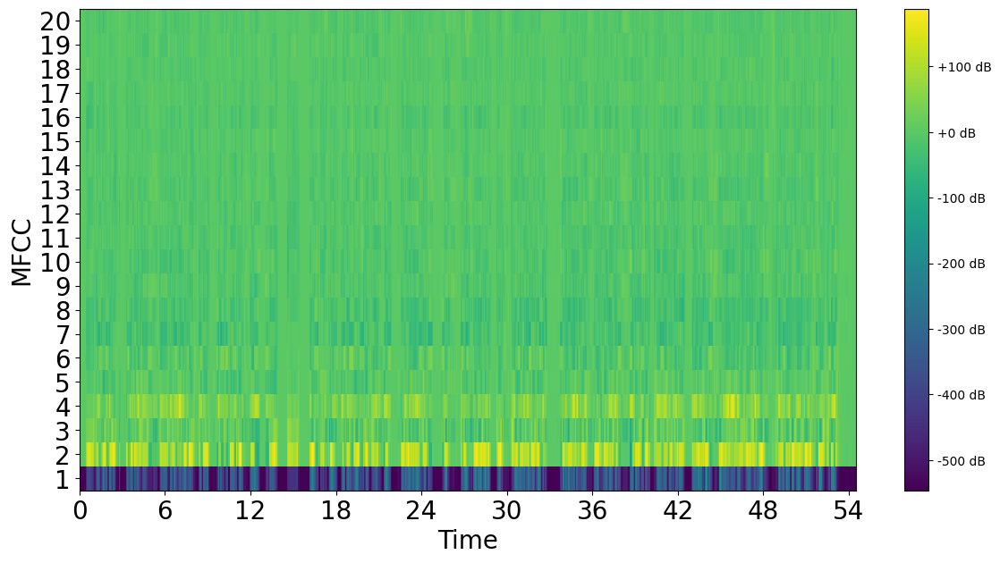

In [900]:
plot_mfcc(audio_dev_samples[66][0], audio_dev_samples[66][1])

 - Storing them CSV files for future use

In [ ]:
dev_mffc_features.to_csv('mfc_features_dev_extended.csv', index=True)
mffc_ev_features.to_csv('mfc_features_ev_extended.csv', index=True)

### **Import Dataset**

In [923]:
def load_dataset(file_path):
    """
    Loads the dataset from a CSV file and processes it for further analysis.

    - Converts 'gender' and 'ethnicity' columns to categorical data types.
    - Extracts the scalar value from the 'tempo' column, which contains arrays.
    - Drops unnecessary columns ('sampling_rate' and 'path').

    :param file_path: Path to the CSV file
    :return: Processed DataFrame
    """
    
    df = pd.read_csv(file_path, index_col='Id',
        dtype=  {
            "gender": "category",
            "ethnicity": "category",            
        }
    )
    
    #Tempo column's values are stored in arrays that contain only single value, so this line converts an array to scalar litteraly, for simplicity
    df["tempo"] = df["tempo"].apply(lambda cell: ast.literal_eval(cell)[0])
    df = df.drop(["sampling_rate", "path"], axis=1)
    
    return df


In [1032]:
df = load_dataset(file_path=f"{root}/development.csv")
df_ev = load_dataset(file_path=f"{root}/evaluation.csv")

### **Load additional features**

In [1033]:
def load_additional_features(df, file_path):
    """
    Loads additional features from a CSV file and appends them to the existing DataFrame.

    :param df: Original DataFrame to which the new features will be added
    :param file_path: Path to the CSV file containing additional features
    :return: Updated DataFrame with appended features
    """
    
    df2 = pd.read_csv(file_path, index_col='Id')  
    df = pd.concat([df, df2], axis=1)
    
    return df
    

In [1034]:
df = load_additional_features(df, file_path="additional_features_dev_extended.csv")
df_ev = load_additional_features(df_ev, file_path="additional_features_ev_extended.csv")

- Adding MFCC also

In [1035]:
df = load_additional_features(df, file_path="mfc_features_dev_extended.csv")
df_ev = load_additional_features(df_ev, file_path="mfc_features_ev_extended.csv")

<!--  -->

### **Exploratory Data Analysis**


- Dimension of dataset

In [1036]:
print(f"The shape of the dev dataset is: {df.shape}")
print(f"The shape of the evaluation dataset is: {df_ev.shape}")

The shape of the dev dataset is: (2933, 128)
The shape of the evaluation dataset is: (691, 127)


- Preview of the dataset

In [1037]:
df.head()

,age,gender,ethnicity,mean_pitch,max_pitch,min_pitch,jitter,shimmer,energy,zcr_mean,...,mfc_18_min,mfc_18_max,mfc_19_mean,mfc_19_std,mfc_19_min,mfc_19_max,mfc_20_mean,mfc_20_std,mfc_20_min,mfc_20_max
Id,,,,,,,,,,,,,,,,,,,,,
0,24.0,female,arabic,1821.6906,3999.7170,145.43066,0.013795,0.082725,0.002254,0.210093,...,-35.970560,24.495447,-9.610289,8.075049,-39.085876,21.935574,-4.279837,8.648903,-39.572533,46.742870
1,22.5,female,hungarian,1297.8187,3998.8590,145.37268,0.025349,0.096242,0.007819,0.078849,...,-19.662354,16.806980,-4.290013,5.496738,-20.198391,13.767784,-3.969665,5.963546,-21.906925,10.394297
2,22.0,female,portuguese,1332.8524,3998.8025,145.42395,0.019067,0.119456,0.002974,0.105365,...,-17.504860,20.046356,-2.095426,6.612457,-23.516533,14.670422,0.489348,5.717770,-19.322495,19.385006
3,22.0,female,english,1430.3499,3998.4510,147.98083,0.017004,0.102389,0.022371,0.173701,...,-38.480247,27.856358,-11.463017,9.401765,-48.444683,14.945332,-1.825905,9.112803,-31.276117,28.906887
4,22.0,male,dutch,1688.7234,3998.6113,145.44772,0.028027,0.124831,0.005369,0.107279,...,-21.992073,20.774052,-0.031597,6.273017,-27.298855,16.257458,2.514096,6.608789,-17.676613,19.857710


- Summary of data

In [932]:
df.describe()

,age,mean_pitch,max_pitch,min_pitch,jitter,shimmer,energy,zcr_mean,spectral_centroid_mean,tempo,...,mfc_18_min,mfc_18_max,mfc_19_mean,mfc_19_std,mfc_19_min,mfc_19_max,mfc_20_mean,mfc_20_std,mfc_20_min,mfc_20_max
count,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,...,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000,2933.000000
mean,27.897886,1189.536569,3779.570485,146.934930,0.021190,0.107741,0.005208,0.104774,2176.369847,125.085771,...,-20.779771,20.643432,-3.524571,6.934818,-24.227965,16.786640,-1.346062,6.787253,-21.379185,19.357767
std,13.093316,414.193673,532.847869,3.757917,0.006626,0.029005,0.006074,0.051646,578.925294,33.812698,...,9.908849,7.470292,4.368399,1.351761,8.367911,8.641233,4.321342,1.365049,8.399634,9.326135
min,6.000000,346.974330,935.515560,145.349140,0.007292,0.045205,0.000028,0.015947,692.116731,51.679688,...,-73.611740,0.592594,-21.591000,3.382334,-61.155525,-2.219257,-18.368720,3.359247,-64.205630,-1.706893
25%,19.000000,818.922360,3948.234400,145.419140,0.016734,0.087378,0.001960,0.060733,1740.756716,103.359375,...,-27.228626,15.721924,-6.424211,6.065093,-29.474550,11.118116,-4.254558,5.882269,-26.595417,13.741070
50%,23.000000,1208.998300,3998.397200,145.622010,0.020525,0.104697,0.003716,0.098964,2150.814043,117.453835,...,-20.266186,19.865538,-3.379084,6.741100,-23.518547,15.671505,-1.365977,6.568536,-20.758577,17.760860
75%,32.000000,1523.777700,3999.485400,146.820890,0.024558,0.124993,0.006338,0.139559,2566.190670,143.554688,...,-13.546861,24.377142,-0.589686,7.566336,-18.257431,20.751650,1.643730,7.405271,-15.557171,22.522230
max,97.000000,2724.892800,3999.792500,202.040700,0.096153,0.265167,0.129114,0.335976,4144.132595,287.109375,...,1.298292,64.833240,10.824322,16.288733,2.167927,77.664185,17.757360,16.847845,6.010162,86.014650


- Checking for NaN values


In [933]:
df.isna().sum() #It returns num of nan values per each column

age            0
gender         0
ethnicity      0
mean_pitch     0
max_pitch      0
              ..
mfc_19_max     0
mfc_20_mean    0
mfc_20_std     0
mfc_20_min     0
mfc_20_max     0
Length: 128, dtype: int64

In [934]:
df.isna().sum().sum()

np.int64(0)

#### **Observations**:
- The dataset contains 2 categorical features: **Gender** and **Ethnicity**
- It includes 126 numerical features
- The target variable is **Age**
- There are no missing values in dataset

#### **Exploring Categorical Features** 



In [935]:
categorical = ["gender", "ethnicity"]
print(f"The categorical variables are: {categorical}")
df.describe(include="category")

The categorical variables are: ['gender', 'ethnicity']


,gender,ethnicity
count,2933,2933
unique,2,165
top,female,igbo
freq,1468,1081


 - Frequency distribution of categorical variables

In [937]:
for category in categorical:
    print(df[category].value_counts(normalize=True))
    print()
    

gender
female    0.500511
male      0.499489
Name: proportion, dtype: float64

ethnicity
igbo          0.368565
english       0.197409
arabic        0.034777
mandarin      0.022162
french        0.021480
                ...   
rundi         0.000341
satawalese    0.000341
sarua         0.000341
sardinian     0.000341
sa'a          0.000341
Name: proportion, Length: 165, dtype: float64



In [1038]:
df["ethnicity"].value_counts(normalize=True).nlargest(30).sum()

np.float64(0.8646437095124446)

#### **Observations**:
- The dataset is balanced with respect to the gender category
- The dataset is imbalanced in terms of ethnicities. Igbo and English are the most dominant
- There are 165 unique ethnicities in total, but the top 30 ethnicities (in terms of distribution) cover over 85% of the data, which can idicate that the majority of the ethnicities may be redundant for the regression task

#### **Exploring Numerical Features** 


In [939]:
def plot_feature_distribution(df):
    """
    Plots the distribution of each feature in the DataFrame.

    - Creates a histogram for each feature.

    :param df: DataFrame containing the features to be plotted
    :return: None (Displays the plot)
    """
    
    feature_names = df.columns
    num_features = len(feature_names)
    
    rows = (num_features + 2) // 3  # 3 plots per row
    cols = 3
    
    fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 5))
    axes = axes.flatten()  # for easier iterations
    
    for i, feature in enumerate(feature_names):
        axes[i].hist(df[feature], bins=30, edgecolor='k', alpha=0.7)
        axes[i].set_title(f"Distribution of {feature}", fontsize=12)
        axes[i].set_xlabel(feature)
        axes[i].set_ylabel("Count")
    
    # Turn off subplots that we havent used!!
    for j in range(len(feature_names), len(axes)):
        axes[j].axis('off')
    
    plt.tight_layout()
    plt.show()


#### **Dependent (Target) variable**

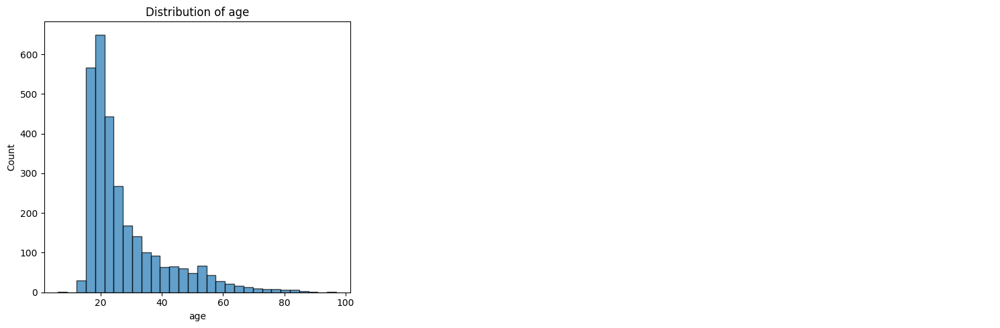

In [940]:
plot_feature_distribution(df[['age']])

#### **Observations**:

  - The majority of speakers are in the younger age range, specifically between 15 and 30 years old. The number of speakers significantly decreases with increasing age
  - The dataset is right-skewed, which can point to an imbalance that may influence the model's predictions

#### **Independent variables**

In [941]:
numerical_features = df.select_dtypes(include=['number']).columns[1:] #We don't want to include age here

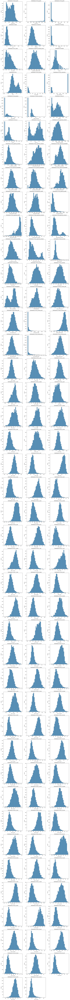

In [942]:
plot_feature_distribution(df[numerical_features])

#### **Observations**:

- Most extracted features show a normal distribution with slight deviations
- Features like max_pitch, min_pitch, and mean_tonnetz are strongly skewed (left or right)
- Outliers will be analyzed by using the Interquartile Range (IQR) method

### **Correlations**

- Due to the high dimensionality of the dataset, plotting a correlation matrix is not very informative
- Some degree of correlation among features is expected
- Plotting feature-target correlations could help identify strong relationships between specific features and the target, though we do not anticipate this

In [943]:
def plot_feature_target_correlation(data, target):
    
    """
    Plots the correlation between each feature and the target variable (Age).

    - Creates a scatter plot for each feature against the target.

    :param data: DataFrame containing the features to be plotted
    :param target: Series containing the target variable (Age)
    :return: None (Displays the plot)
    """
    
    feature_names = data.columns
    rows = (len(feature_names) + 2) // 3
    cols = 3
        
    fig, axes = plt.subplots(rows, cols, figsize=(15, rows * 5), constrained_layout=True)
    axes = axes.flatten() 

    for i, feature_name in enumerate(feature_names):
        axes[i].scatter(data[feature_name], target, alpha=0.6, edgecolor='k')
        axes[i].set_title(feature_name, fontsize=10)
        axes[i].set_xlabel(feature_name, fontsize=8)
        axes[i].set_ylabel("Age", fontsize=8)
        
    for j in range(len(feature_names), len(axes)):
        fig.delaxes(axes[j])

    plt.suptitle("Feature vs. Target Correlation", fontsize=16)
    plt.show()

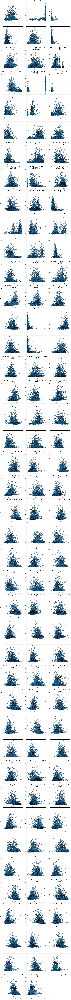

In [944]:
plot_feature_target_correlation(df[numerical_features], df["age"])

In [949]:
abs(df[numerical_features].corrwith(df["age"])).nlargest(30)

silence_duration          0.514127
num_words                 0.473499
num_characters            0.473403
mfc_7_min                 0.465439
max_spectral_contrast     0.450660
hnr                       0.446880
mean_tempogram            0.444532
num_pauses                0.437670
std_spectral_contrast     0.412082
mfc_14_min                0.407381
mfc_9_min                 0.400533
mfc_16_min                0.397914
mfc_7_mean                0.393752
mfc_12_min                0.391648
mfc_18_min                0.390307
mfc_10_min                0.389871
mfc_5_min                 0.380367
min_spectral_bandwidth    0.361342
mfc_20_min                0.345932
max_zcr                   0.335115
std_tempogram             0.328751
mfc_19_min                0.327654
min_tonnetz               0.327082
mfc_15_max                0.318214
mean_pitch                0.315645
mfc_14_mean               0.315284
max_tonnetz               0.307459
mfc_8_min                 0.304596
mfc_2_max           

#### **Observations**:
- Many features had a moderate correlation with the target variable.
- The number of words and number of characters are likely to be highly correlated, but let's calculate the exact correlation between these two features

In [950]:
correlation = df['num_characters'].corr(df['num_words'])
print(correlation)

0.9998901262329757


- Since the correlation is 1, we can drop one of these two features

In [951]:
df = df.drop('num_characters', axis=1)
df_ev = df_ev.drop('num_characters', axis=1)

### **Feature-target separation**


In [952]:
X = df.iloc[:, 1:len(df)-1]
y = df["age"]

### **One hot Encoding**

- Categorical variables need to be converted into binary vectors. We will apply One-Hot Encoding. Each category becomes a new column with 1 for presence and 0 for absence. If a category not present in the dataset appears, it will be represented as a zero vector

In [953]:

def one_hot_encoding(X, categorical_columns, encoder=None):
    """
    Performs One-Hot Encoding on specified categorical columns in the DataFrame.

    - If the encoder is not provided, a new OneHotEncoder is fitted on the categorical columns.
    - The categorical columns are replaced by their one-hot encoded representation.
    - If the encoder is provided (e.g., from training data), the transformation is applied without re-fitting.
    - The resulting encoded columns are concatenated with the original DataFrame after removing the original categorical columns.

    :param X: DataFrame with features (including categorical columns).
    :param categorical_columns: List of column names representing categorical variables.
    :param encoder: A pre-fitted OneHotEncoder instance (optional). If None, a new encoder is fitted.
    :return: A DataFrame with one-hot encoded columns and the fitted encoder.
    """

    one_hot_encoded = None
    
    #If we train first
    if encoder is None:
        encoder = OneHotEncoder(sparse_output=False, handle_unknown='ignore')
        one_hot_encoded = encoder.fit_transform(X[categorical_columns]) 
    else:
        one_hot_encoded = encoder.transform(X[categorical_columns]) 
    
    #Transforming it into the Data Frame
    one_hot_df = pd.DataFrame(one_hot_encoded, columns=encoder.get_feature_names_out(categorical_columns))

    X = X.drop(categorical_columns, axis=1) 
    one_hot_df.index = X.index 
    X = pd.concat([X, one_hot_df], axis=1)
    
    return X, encoder

In [954]:
X, one_hot_encoder = one_hot_encoding(X, ["gender", "ethnicity"])
df_ev, _ = one_hot_encoding(df_ev, ["gender", "ethnicity"], one_hot_encoder)
feature_names = X.columns

- The dimensionality of our dataset increased to 291 after encoding the gender and ethnicity columns

In [955]:
X.shape

(2933, 291)

### **Dataset split**

- We will split the data to assess how different models perform and obtain preliminary results
- The models we will evaluate include **Linear Regression**, both with and without **Ridge regularization**, as well as the **Random Forest Regressor**.

In [956]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state=42) 

### **Data Standardization**
-  While both Linear Regression and Random Forest Regressor do not require data standardization, we will apply it to ensure consistency when using Ridge regularization. Standardizing the data once will not affect the performance of Linear Regression or Random Forest, but it will ensure proper handling of the regularization term in Ridge Regression. This way, we can avoid standardizing separately for each model

In [957]:
def standardize_data(X, feature_names, scaler = None):
    """
    Standardizes the specified columns in the DataFrame using StandardScaler.
    
    If no scaler is provided, a new StandardScaler is fitted to the data. 
    Otherwise, the existing scaler is used to transform the data.

    :param X: DataFrame with the features to be standardized.
    :param feature_names: List of column names to be standardized.
    :param scaler: Pre-fitted StandardScaler (optional).
    :return: A tuple of the standardized DataFrame and the fitted scaler.
    """
    
    if scaler is None:
        scaler = StandardScaler()
        X[feature_names] = scaler.fit_transform(X[feature_names])
    else:
        X[feature_names] = scaler.transform(X[feature_names])
    
    return X, scaler
    

In [958]:
numerical_features = X_train.columns[:124] # Num of characters is dropped, so numerical features variable must be updated

X_train, scaler = standardize_data(X_train, numerical_features)
X_test, _ = standardize_data(X_test, numerical_features, scaler)

### **Cross validation**
- To avoid potential bias from a single train-test split, a more reliable measure of model performance is achieved through cross-validation

**The function below is designed to be compatible with the PCA approach to reduce code redundancy. While the PCA approach will be introduced later, for now, it only uses the code within the if section**

In [1015]:
def cross_validation_score(X, y, flag="N", num_of_components=0):
    """
    Performs cross-validation to evaluate model performance using multiple algorithms.

    This function supports two modes:
    1. **Without PCA**: It scales numerical features using StandardScaler.
    2. **With PCA**: It scales numerical features using StandardScaler and then applies PCA for dimensionality reduction.

    The function computes the average cross-validated root mean squared error (RMSE) for three models:
    - Random Forest Regressor
    - Linear Regression
    - Ridge Regression

    Cross-validation is performed using KFold with 5 splits. The models are evaluated based on their RMSE performance.

    :param X: DataFrame of feature variables.
    :param y: Target variable.
    :param flag: Flag to choose whether to include PCA. "N" for no PCA, any other value for PCA.
    :param num_of_components: Number of components to retain if PCA is used.
    :return: A dictionary with model names as keys and their corresponding average RMSE scores as values.
    """
    numerical_features = X.columns[:124]
    encoded_categorical_features = X.columns[124:]
    
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    preprocessor=None
    
    if flag == "N":        
        preprocessor = ColumnTransformer([
            # ('onehot', OneHotEncoder(handle_unknown='ignore'), categorical_features),
            ('scaler', StandardScaler(), numerical_features)
        ])
    else:
        preprocessor = ColumnTransformer(
            transformers=[
                ('num', Pipeline([
                    ('scaler', StandardScaler()),  
                    ('pca', PCA(n_components=num_of_components)) 
                ]), numerical_features),
                ('cat', 'passthrough', encoded_categorical_features)
            ]
        )
        

    models = {
        "Random Forest Regressor": RandomForestRegressor(random_state=42),
        "Linear Regression": LinearRegression(),
        "Ridge Regression": Ridge(),
    }

    results = {}

    for model_name, model in models.items():
        pipeline = Pipeline([
            ('preprocessor', preprocessor),  
            ('model', model)  
        ])
        
        scores = cross_val_score(pipeline, X, y, cv=kf, scoring="neg_root_mean_squared_error")
        results[model_name] = np.mean(-scores)

    return results


- A function for comparing the results of different models.

In [976]:
def plot_model_scores(*results, labels=None, group_names=None):
    """
    Plots a grouped bar chart to compare different models' performances.

    Parameters:
    - results: Variable number of result lists or arrays, where each array corresponds to the performance results
              of a model for different approaches.
    - labels: List of labels for the x-axis (e.g., categories or approaches). Optional.
    - group_names: List of names for the groups (e.g., model names like ['Model 1', 'Model 2', ...]). Optional.
    """
    
    n_models = len(results[0])
    n_approaches = len(results)

    x = np.arange(n_models)
    bar_width = 0.45 / n_approaches  # Width of bars divided among result groups

    fig, ax = plt.subplots(figsize=(14, 7))
     
    for i, res in enumerate(results):
        offset = (i - (n_approaches - 1) / 2) * bar_width
        
        if group_names is None:
            label = "Final"
        else:
            label = group_names[i]
            
        bars = ax.bar(x + offset, res, bar_width, label=label, alpha=0.7)
        
        # Put value at the top of each bar
        for bar in bars:
            yval = bar.get_height()
            ax.text(bar.get_x() + bar.get_width() / 2, yval + 0.02, f'{yval:.3f}', ha='center', va='bottom')

    ax.set_xlabel('Models')
    ax.set_ylabel('RMSE')
    ax.set_title('Models Performance Comparison', fontsize=14)
    ax.set_xticks(x)
    ax.set_xticklabels(labels)
    ax.legend()

    plt.yticks(fontsize=20)    
    

    plt.tight_layout()
    
    # plt.savefig('rfcv.svg')

    plt.show()


## **Linear Regression**

In [961]:
l_reg = LinearRegression(fit_intercept=True)
l_reg.fit(X_train, y_train)

y_predict = l_reg.predict(X_test)

rmse_lr = root_mean_squared_error(y_test, y_predict)
    
print(f"Root Mean Squared Error for Linear Regression is: (RMSE): {rmse_lr}")

Root Mean Squared Error for Linear Regression is: (RMSE): 9.575855027181953


## **Ridge Regression: Regularized Linear Regression**

In [962]:
ridge = Ridge() 
ridge.fit(X_train, y_train)

y_predict = ridge.predict(X_test)

rmse_rr = root_mean_squared_error(y_test, y_predict)
    
print(f"Root Mean Squared Error for Ridge Regression is: (RMSE): {rmse_rr}")

Root Mean Squared Error for Ridge Regression is: (RMSE): 9.485897437102572


## **Random Forest Regressor**

In [963]:
rf_regressor = RandomForestRegressor(random_state=42)
rf_regressor.fit(X_train, y_train)

y_pred = rf_regressor.predict(X_test)

rmse_rf = root_mean_squared_error(y_test, y_pred)

print(f"Root Mean Squared Error for Random Forest Regressor is: {rmse_rf}")

Root Mean Squared Error for Random Forest Regressor is: 9.461971093601475


In [964]:
holdout_results = {
    "Random Forest Regressor": rmse_rf,
    "Linear Regression": rmse_lr,
    "Ridge Regression": rmse_rr,
}

#### Random Forrest Regression achieved a slight better result than Linear and Ridge Regression, but lets focus on cross validation results

### **Cross-Validation for All Models**


In [969]:
cross_valid_results = cross_validation_score(X, y)

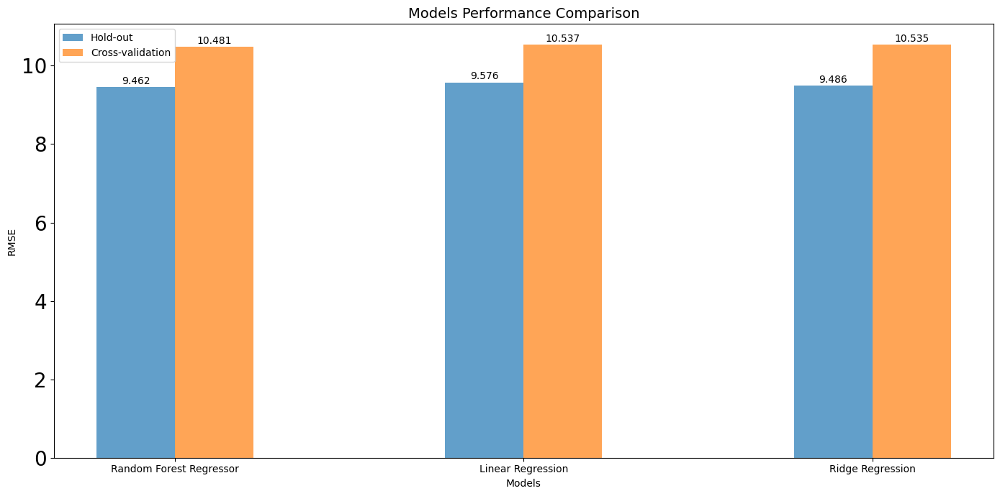

In [977]:
plot_model_scores(holdout_results.values(), cross_valid_results.values(), group_names=["Hold-out", "Cross-validation"] , labels=holdout_results.keys())

#### **Observations**:

- The hold-out approach gave slightly better results than cross-validation
- The models performed similarly, but Random Forest Regressor gave the best results
- Ridge regularization improved performance in the holdout set, but made a little difference in cross-validation

## **Outliers handling**

#### Random Forest Regression is known to be robust against outliers, while Linear Regression is sensitive to them. We decided not to handle outliers initially to see the first results. In the next step, we plan to use the IQR method to check if handling outliers will improve our performance.

### **IQR Method**

In [966]:
def plot_boxplot(X):
    """
    Plots a boxplot for each column in the DataFrame on separate subplots.

    Parameters:
    - X: DataFrame containing the data to plot (multiple columns allowed).
    
    :return: None (Displays the plot)
    """
    
    n_cols = len(X.columns)
    rows = (n_cols + 2) // 3 

    fig, ax = plt.subplots(rows, 3, figsize=(15, rows * 5))
    ax = ax.flatten()

    for i, column in enumerate(X.columns):
        ax[i].boxplot(X[column], vert=True, patch_artist=True)
        ax[i].set_title(f'Boxplot of {column}', fontsize=12)
        ax[i].set_xlabel(column, fontsize=10)
        ax[i].set_ylabel("Values", fontsize=10)

    for j in range(i + 1, len(ax)):
        fig.delaxes(ax[j])

    plt.tight_layout()
    plt.show()

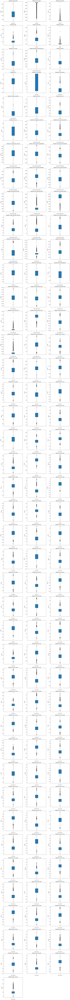

In [967]:
plot_boxplot(X[numerical_features])

- Analyzing the boxplots for various features reveals that some of them have numerous outliers based on the IQR method
- Removing these outliers would significantly reduce the dataset's size, so we will instead apply mean imputation and capping approaches

In [968]:
def handle_outliers(X, columns, criterium):
    """
    Handles outliers in the specified columns of the DataFrame using the given criterium.

    Parameters:
    - X: pd.DataFrame
        The dataset containing the features to process.
        
    - columns: list
        List of feature names (columns) to apply outlier handling.
        
    - criterium: str
        The method to handle outliers. Options:
        - "capping": Caps values beyond the IQR range to the upper and lower limits.
        - "mean": Replaces values beyond the IQR range with the mean of the feature.

    Returns:
    - X: pd.DataFrame
        The modified dataset with handled outliers.

    Notes:
    - Upper and lower limits for outlier detection are calculated using the IQR method:
      upper_limit = Q3 + 1.5 * IQR
      lower_limit = Q1 - 1.5 * IQR
    - The method modifies the original DataFrame in place. Use `.copy()` if you want to preserve the original.
    - Ensure the criterium parameter is either "capping" or "mean" to avoid unexpected behavior.
    """
        
    for feature in columns:
        
        # Convert column to float to allow non-integer values; warning appears without it
        X[feature] = X[feature].astype(float) 
            
        q1 = X[feature].quantile(0.25)
        q3 = X[feature].quantile(0.75)
        
        iqr = q3 - q1
        
        upper_limit = q3 + 1.5 * iqr
        lower_limit = q1 - 1.5 * iqr
        
        
        if criterium == "capping":
            X.loc[(X[feature] > upper_limit), feature] = upper_limit 
            X.loc[(X[feature] < lower_limit), feature] = lower_limit 
        elif criterium == "mean":
            X.loc[(X[feature] > upper_limit), feature] = np.mean(X[feature]) 
            X.loc[(X[feature] < lower_limit), feature] = np.mean(X[feature])
                
    return X

In [971]:
X_outliers = X.copy()
X_outlier_handled_mean = handle_outliers(X_outliers, numerical_features, "mean" )
X_outlier_handled_capping = handle_outliers(X_outliers, numerical_features, "capping" )

In [972]:
outlier_handled_mean = cross_validation_score(X_outlier_handled_mean, y)
outlier_handled_capping = cross_validation_score(X_outlier_handled_capping, y)

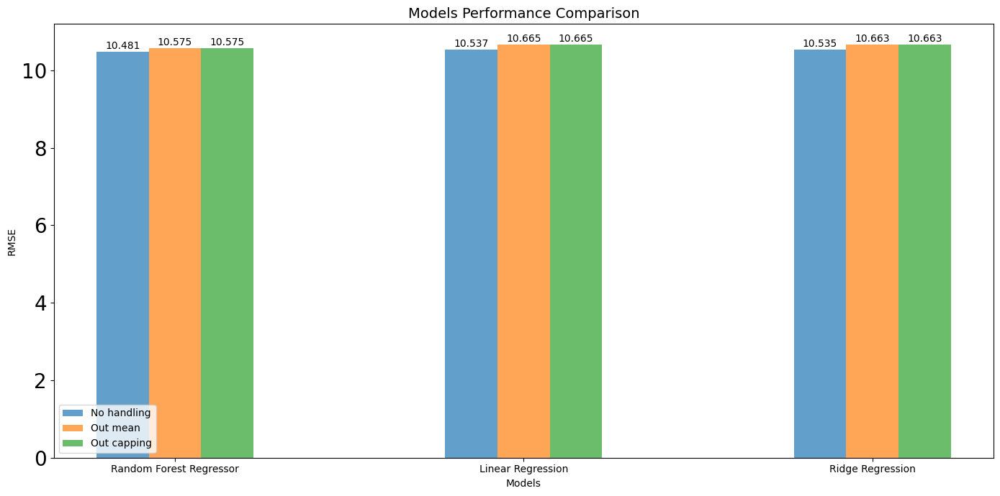

In [ ]:
plot_model_scores(cross_valid_results.values(), outlier_handled_mean.values(), outlier_handled_capping.values(), group_names=["No handling", "Out mean", "Out capping"] , labels=cross_valid_results.keys())

#### **Observations**:

- Handling outliers using the mean or capping with the IQR method resulted in a lower cross-validation score. Thus, the best performance was achieved by keeping all values in their original form

## **Feature Selection**

##### Due to the correlation among various features, it is challenging to determine their individual importance. To address this, we will implement Recursive Feature Elimination with cross-validation (RFECV) using a Random Forest Regressor.

### **Recursive Feature Elimination with Cross-Validation**
- Recursive Feature Elimination with Cross-Validation (RFE with CV) is a technique that iteratively removes the least important features based on model performance
- It uses cross-validation to evaluate the model's performance at each step, ensuring that feature selection is not overfitted to a specific training set
- By combining results from different folds during cross-validation, RFE with CV selects the most relevant features that contribute to the model's overall performance and generalization

In [852]:
features_sorted = sorted(zip(feature_names, rf_regressor.feature_importances_), key=lambda x: x[1], reverse=True)
features_sorted

[('silence_duration', np.float64(0.2686596380283901)),
 ('ethnicity_english', np.float64(0.025682856636445858)),
 ('std_spectral_contrast', np.float64(0.02003719417677229)),
 ('mean_spectral_bandwidth', np.float64(0.014184559851982295)),
 ('mean_chroma_sens', np.float64(0.011935356254525645)),
 ('num_pauses', np.float64(0.010265880682640354)),
 ('mfc_7_std', np.float64(0.010028850889151595)),
 ('hnr', np.float64(0.009516290941435288)),
 ('std_chroma_sens', np.float64(0.00929616531239698)),
 ('mfc_5_mean', np.float64(0.00895754894737732)),
 ('mfc_7_min', np.float64(0.008896673949579747)),
 ('mfc_1_max', np.float64(0.008610480758537157)),
 ('mfc_10_min', np.float64(0.008395617503983483)),
 ('mfc_17_min', np.float64(0.007968271137466067)),
 ('mfc_7_mean', np.float64(0.007817298793598583)),
 ('mfc_8_max', np.float64(0.007713885543333429)),
 ('mfc_5_max', np.float64(0.0076607514309091065)),
 ('mfc_6_std', np.float64(0.007655440253349044)),
 ('mfc_3_std', np.float64(0.00765328495459778)),
 (

- We can see that many features have an importance value of zero, which can indicate that some of them are redundant

In [ ]:
min_features_to_select = 145  # Minimum number of features to consider    
reg = RandomForestRegressor()
cv = KFold(n_splits=5, shuffle=True)

rfecv = RFECV(
    estimator=reg,
    step=10,
    cv=cv,
    scoring="neg_root_mean_squared_error",
    min_features_to_select=min_features_to_select,
    n_jobs=-1,
)

rfecv.fit(X, y)
num_of_features = rfecv.n_features_
print(f"Optimal number of features: {rfecv.n_features_}") #ovdje ipak namjesti da bude 171
        

Optimal number of features: 171


In [980]:
def plot_rfecv_comparasion(rfecv):
    """
    Plots the comparison of the number of features against the RMSE during RFECV (Recursive Feature Elimination with Cross-Validation).

    Parameters:
    - rfecv: The RFECV object containing the results of feature elimination.
    
    """
    
    nums = rfecv.cv_results_['n_features']
    results = np.abs(rfecv.cv_results_["mean_test_score"])
    
    plt.figure(figsize=(10, 6))
    plt.plot(nums, results, marker='o')
    
    plt.scatter(171, results[3], color='red', zorder=5)  # Add red point
    plt.text(171, results[3], str(171), color='red', fontsize=12, verticalalignment='bottom', horizontalalignment='left')

    plt.xlabel("Number of Features")
    plt.ylabel("Root Mean Squared Error")
    plt.grid(True)
    #plt.savefig("rfcv.svg")
    plt.show()



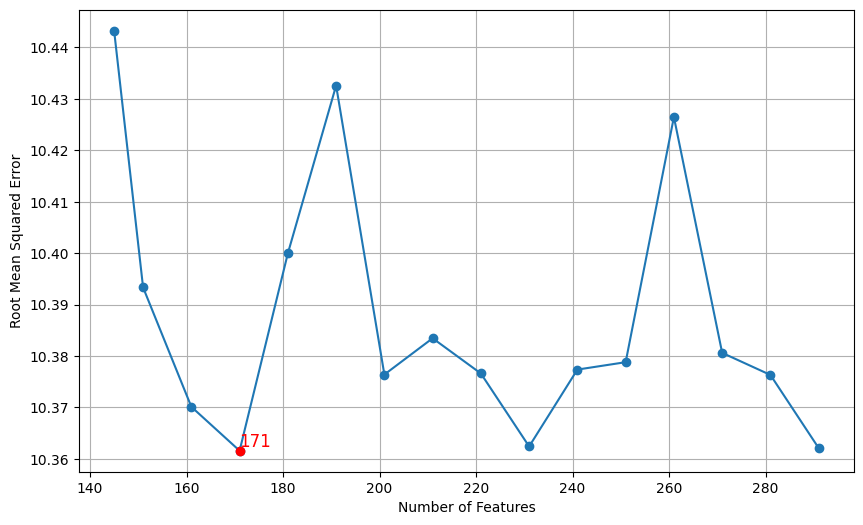

In [979]:
plot_rfecv_comparasion(rfecv)

- Saving features for future use, since the call is time consuming

In [982]:
selected_features = X.columns[rfecv.support_]  # getting columns
features = pd.DataFrame(zip(selected_features.values,rfecv.ranking_), columns=["features","ranking"])
features.to_csv("Imp_features.csv") #It is very time consuming, so save them to csv for future use

- After applying RFECV, we found that the optimal number of features is 171. Moreover, this method ranks all 171 features according to their importance

- An interesting observation is that all the removed features were the ethnicity-related features

In [1040]:
# selected_features = X.columns[rfecv.support_]  # getting columns

selected_features_df = pd.read_csv("Imp_features.csv") # 

selected_features = selected_features_df["features"].values
ranking = selected_features_df["ranking"].values

print("Selected features:", selected_features)
print("Feature ranking:", ranking)


Selected features: ['mean_pitch' 'max_pitch' 'min_pitch' 'jitter' 'shimmer' 'energy'
 'zcr_mean' 'spectral_centroid_mean' 'tempo' 'hnr' 'num_words'
 'num_pauses' 'silence_duration' 'std_zcr' 'min_zcr' 'max_zcr'
 'std_spectral_centroid' 'min_spectral_centroid' 'max_spectral_centroid'
 'mean_spectral_bandwidth' 'std_spectral_bandwidth'
 'min_spectral_bandwidth' 'max_spectral_bandwidth' 'mean_spectral_rolloff'
 'std_spectral_rolloff' 'min_spectral_rolloff' 'max_spectral_rolloff'
 'mean_spectral_contrast' 'std_spectral_contrast' 'min_spectral_contrast'
 'max_spectral_contrast' 'mean_tonnetz' 'std_tonnetz' 'min_tonnetz'
 'max_tonnetz' 'mean_tempogram' 'std_tempogram' 'mean_chroma_stft'
 'std_chroma_stft' 'min_chroma_stft' 'mean_chroma_sens' 'std_chroma_sens'
 'min_chroma_sens' 'max_chroma_sens' 'mfc_1_mean' 'mfc_1_std' 'mfc_1_min'
 'mfc_1_max' 'mfc_2_mean' 'mfc_2_std' 'mfc_2_min' 'mfc_2_max' 'mfc_3_mean'
 'mfc_3_std' 'mfc_3_min' 'mfc_3_max' 'mfc_4_mean' 'mfc_4_std' 'mfc_4_min'
 'mfc_4_max' 

## **Evaluating models with a reduced set of features**

In [983]:
X_reduced = X[selected_features] 
X.shape, X_reduced.shape

((2933, 291), (2933, 171))

In [984]:
reduced_fet_scores = cross_validation_score(X_reduced, y)
reduced_fet_scores

{'Random Forest Regressor': np.float64(10.480706900227977),
 'Linear Regression': np.float64(10.537383484239275),
 'Ridge Regression': np.float64(10.534641235208593)}

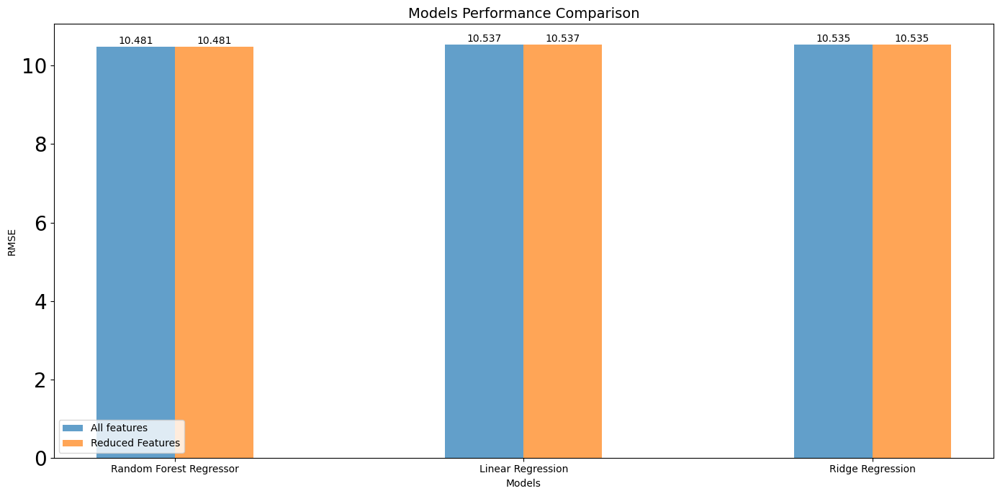

In [985]:
plot_model_scores(cross_valid_results.values(), reduced_fet_scores.values(), group_names=["All features", "Reduced Features"] , labels=cross_valid_results.keys())

#### **Observations**
- The results remain largely consistent, while we successfully reduced the dataset's dimensionality by 120 features

## **Principal Component Analysis (PCA)**

##### In some related works mentioned in the report's references, Principal Component Analysis (PCA) was applied to reduce the dimensionality of the extracted audio features. We will also attempt to implement this approach and evaluate its impact on our models. 


**We will implement a classic step-by-step PCA pipeline on the X_train and X_test datasets obtained through a hold-out split, using only numerical features and excluding one-hot encoded variables. For cross-validation, a separate pipeline object will be integrated into the `cross_val_score` function.**

In [987]:
X_train_num = X_train[numerical_features]
X_test_num = X_test[numerical_features]

- Before applying PCA, standardization is important since it ensures that each feature contributes equally to the principal components

- We have already standardized X_train and X_test, so it is not necessary to do it again



In [989]:
def plot_pca_variances_ratio(dfx_pca):
    """
    Plots the explained variance ratio for each principal component from the PCA fit.

    Parameters:
    - dfx_pca: PCA object with the 'explained_variance_ratio_' attribute.
    
    :return: None (Displays the plot)
    """
    y_positions = np.arange(len(dfx_pca.explained_variance_ratio_))  # Original order

    plt.figure(figsize=(30, len(y_positions) * 0.45))
    plt.barh(y=y_positions,
            width=dfx_pca.explained_variance_ratio_,
            edgecolor='k', alpha=0.75, height=0.7)  

    for i, value in enumerate(dfx_pca.explained_variance_ratio_):
        plt.text(value, y_positions[i], f'{value:.3f}', fontsize=15, va='center', ha='left')



    plt.grid(True)
    plt.title("Percentage of Explained Variances", fontsize=25)
    plt.ylabel("Principal components", fontsize=18) 
    plt.yticks(y_positions, [f"PC{i+1}" for i in y_positions], fontsize=15) 
    plt.xticks(fontsize=15)
    plt.xlabel("Explained variance ratio", fontsize=18)
    
    
    plt.ylim(min(y_positions)-1, max(y_positions)+1) # adjusting top and bottom margins
    plt.gca().invert_yaxis() #the easiest way to invert plot


    plt.show()

- We will set `explained_variance_ratio` to `None` to analyze the variance explained by each component, and then decide how many components we should keep 

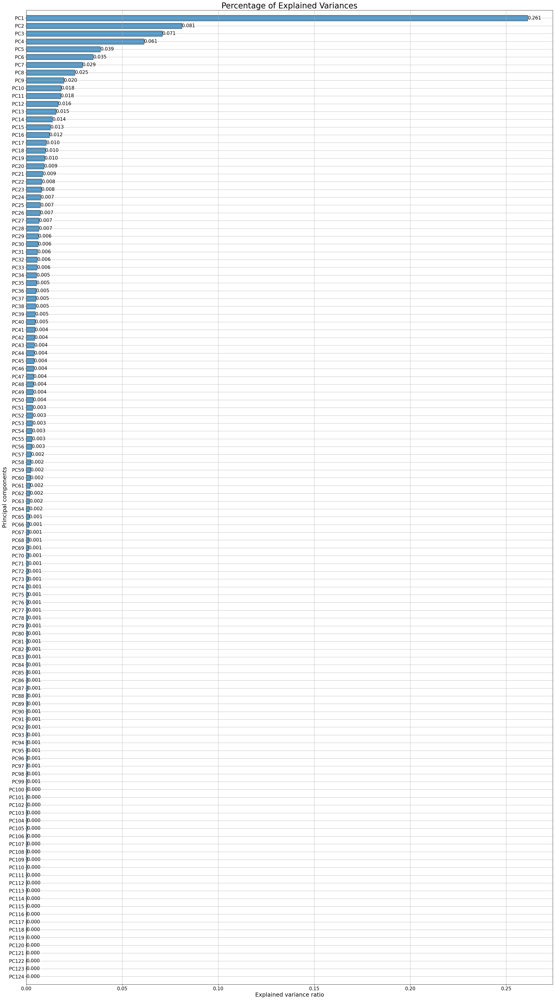

In [990]:
explained_variance_ratio = None
pca = PCA(n_components=explained_variance_ratio)
dfx_pca = pca.fit(X_train_num)

plot_pca_variances_ratio(dfx_pca)

- If we set `explained_variance_ratio` to 0.95, PCA will select the number of components required to explain 95% of the total variance in the data

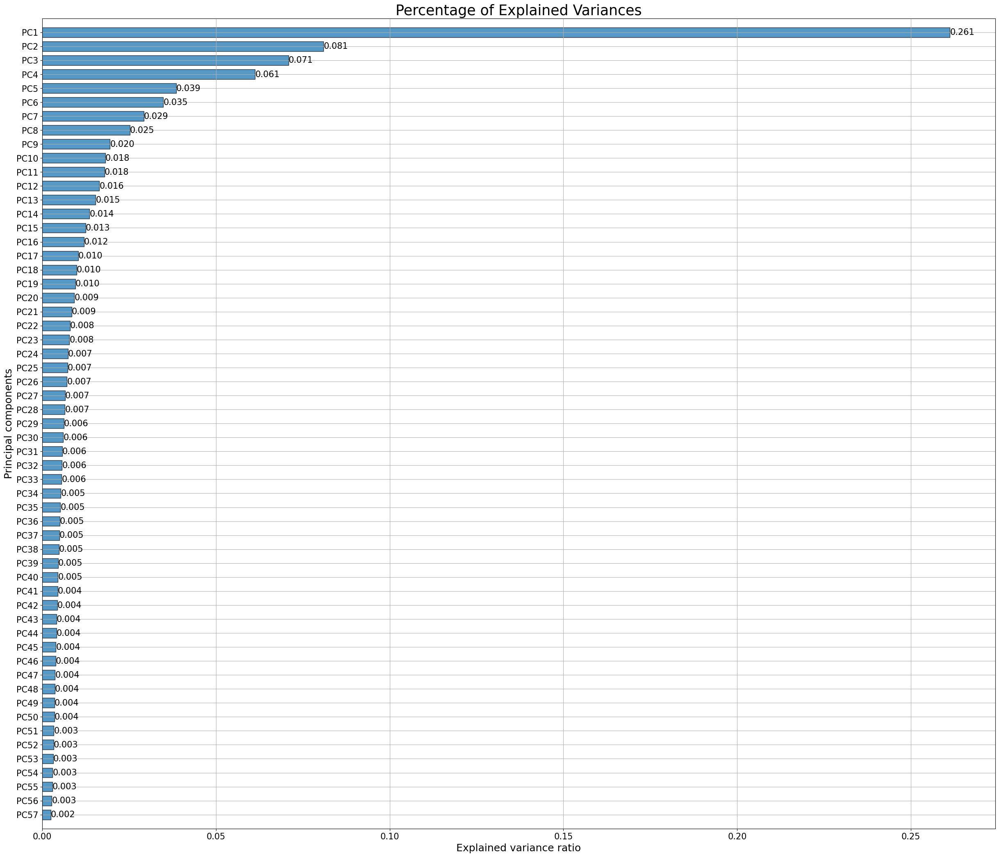

Number of components : 57


In [992]:
explained_variance_ratio = 0.95
pca_95 = PCA(n_components=explained_variance_ratio)
dfx_pca_95 = pca_95.fit(X_train_num)

plot_pca_variances_ratio(dfx_pca_95)

print("Number of components :", dfx_pca_95.n_components_)


- We will use cross-validation to determine the optimal number of principal components

In [252]:
pca_ratios = [0.95, 0.96, 0.97, 0.98, 0.99]
scores = [cross_validation_score(X_reduced, y ,flag="PCA" ,num_of_components=ratio) for ratio in pca_ratios] # Result is the list of dictionaries

In [993]:
scores

[{'Random Forest Regressor': np.float64(10.760136434078962),
  'Linear Regression': np.float64(10.590425747064003),
  'Ridge Regression': np.float64(10.52737826993256)},
 {'Random Forest Regressor': np.float64(10.772728843449219),
  'Linear Regression': np.float64(10.55534806297018),
  'Ridge Regression': np.float64(10.494203062780965)},
 {'Random Forest Regressor': np.float64(10.736715407747818),
  'Linear Regression': np.float64(10.499626440134858),
  'Ridge Regression': np.float64(10.441152098298648)},
 {'Random Forest Regressor': np.float64(10.729666831637001),
  'Linear Regression': np.float64(10.480621552956617),
  'Ridge Regression': np.float64(10.429297689172461)},
 {'Random Forest Regressor': np.float64(10.819952803531862),
  'Linear Regression': np.float64(10.379790944943434),
  'Ridge Regression': np.float64(10.331159582149837)}]

In [996]:
def plot_line_graph_comparison(groups, labels, pca_ratios):
    """
    Plots a line graph comparing RMSE for different models across different principal component thresholds.

    Parameters:
    - results: Results of RMSE for different models at each principal component threshold.
    - labels: Labels for the models to display in the legend.
    - group_names: Optional list of group names to display as x-axis labels.
    - num_components: A list of principal component thresholds (default [0.95, 0.96, 0.97, 0.98]).
    """
    
    plt.figure(figsize=(14, 7))

    for label in labels:
        results = [group[label] for group in groups]     
        plt.plot(pca_ratios, results, label=label, marker='o')

    plt.title("RMSE Comparison for Different Models")
    plt.xlabel("Percentage of Variance Explained", fontsize=16)
    plt.ylabel("RMSE", fontsize=16)
    plt.xticks(pca_ratios, labels=pca_ratios, fontsize=16)
    plt.yticks(fontsize=16)
    plt.legend()
    plt.grid(True)
    plt.savefig('pca.svg')
    plt.show()
    

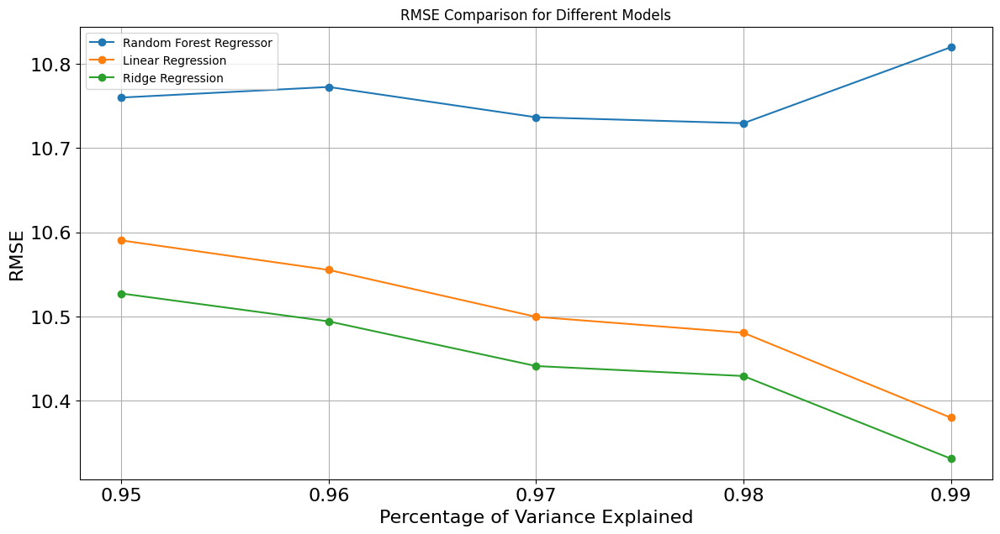

In [997]:
labels = scores[0].keys()
plot_line_graph_comparison(scores, labels, pca_ratios)

- Let's compare these results with the ones achieved using the first feature reduction method to evaluate which approach yields better performance

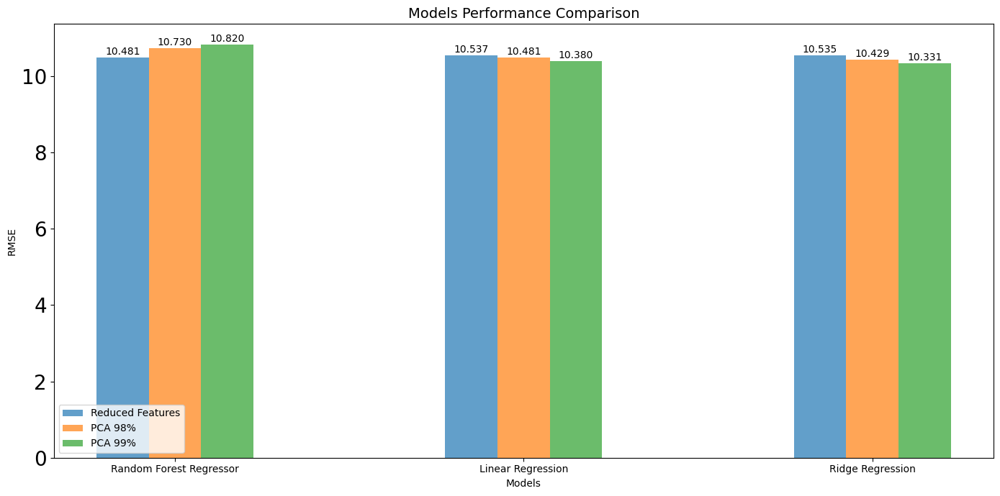

In [998]:
plot_model_scores(reduced_fet_scores.values(), scores[3].values(), scores[4].values(), group_names=["Reduced Features", "PCA 98%", "PCA 99%"] , labels=reduced_fet_scores.keys())

#### **Observations**
- The combination of Random Forest Regressor and PCA has resulted in a decrease in performance, while the combination of Linear Regression and Ridge models has shown a slight improvement in results
- We will select the number of components required to cover 99% of the explained variance, which equals 95 components, but this will only be applied to Linear and Ridge Regression models. Random Forest Regressor will no longer be combined with PCA


## **Hyperparameter tunining**

We will perform hyperparameter tuning for two scenarios:

1. Using features selected by RFECV
2. Using PCA for the Linear Regression and Ridge model .

After tuning, the models will be tested on the evaluation set, and the results will guide the selection of the final model.

In [999]:
def hyperparameter_tuning(X, y, model_type, pca_flag=False):
    """
    Performs hyperparameter tuning for a specified regression model using GridSearchCV.

    Parameters:
    - X: Feature matrix (DataFrame).
    - y: Target variable (Series or array).
    - model_type: Type of model to train ('linear', 'ridge', or 'random_forest').
    - pca_flag: If True, applies PCA for dimensionality reduction (default is False).

    The function:
    1. Preprocesses data using StandardScaler and optional PCA.
    2. Configures a pipeline with the specified model.
    3. Tunes hyperparameters using 5-fold cross-validation.
    4. Prints the best hyperparameters and RMSE score.

    Returns:
    - The trained GridSearchCV object.
    """
        
    numerical_features = X.columns[:124]
    encoded_categorical_features = X.columns[124:]

    preprocessor = None
    steps = []  
    param_grid={}
    
    if pca_flag:
        preprocessor = ColumnTransformer(
        transformers=[
            ('num', Pipeline([
                ('scaler', StandardScaler()),  
                ('pca', PCA(n_components=0.99)) 
            ]), numerical_features),
            ('cat', 'passthrough', encoded_categorical_features)
            ]
        )
        
    else:
        preprocessor = ColumnTransformer([
            ('scaler', StandardScaler(), numerical_features)
        ])
        
        
    steps.append(('preprocessor',preprocessor))
    
    if model_type == 'linear':
        steps.append(('model', LinearRegression()))

    elif model_type == 'ridge':
        steps.append(('model', Ridge()))
        param_grid = {
            'model__alpha': np.arange(0.1, 100, 0.5) 
        }

    elif model_type == 'random_forest':
        steps.append(('model', RandomForestRegressor(random_state=42)))
        param_grid = {
            'model__n_estimators': [100, 200, 300], 
            'model__max_depth': [None, 10, 20, 30],   
            'model__min_samples_split': [2, 5, 10],   
            'model__min_samples_leaf': [1, 2, 4],     
            'model__max_features': ['log2', 'sqrt'],
        }
        
    pipe = Pipeline(steps)
    
    kf = KFold(n_splits=5, shuffle=True, random_state=42)
    grid_search = GridSearchCV(pipe, param_grid, cv=kf, n_jobs=-1, scoring='neg_root_mean_squared_error', )
    grid_search.fit(X, y)

    print(f"Best parameters for {model_type}: {grid_search.best_params_}")
    print(f"Best score (RMSE): {-grid_search.best_score_}")
    print()

    return grid_search
 

- Linear Regression does not require hyperparameter tuning, but for consistency, the `hyperparameter_tuning` function will fit it without modifying any parameters

In [1000]:
linear_models = {"red": hyperparameter_tuning(X_reduced, y, "linear"), "pca": hyperparameter_tuning(X_reduced, y, "linear", pca_flag=True)}

Best parameters for linear: {}
Best score (RMSE): 10.537383484239275

Best parameters for linear: {}
Best score (RMSE): 10.379790944943434



- For the Ridge model, we will test different values of the alpha parameter

In [1001]:
ridge_models = {"red": hyperparameter_tuning(X_reduced, y, "ridge"), "pca": hyperparameter_tuning(X_reduced, y, "ridge", pca_flag=True)}

Best parameters for ridge: {'model__alpha': np.float64(99.6)}
Best score (RMSE): 10.495218802707555

Best parameters for ridge: {'model__alpha': np.float64(7.6)}
Best score (RMSE): 10.301249340619583



- We will not tune hyperparameters for the PCA-scaled dataset with Random Forest, as cross-validation showed a decrease in performance

In [410]:
rf_models = {"red": hyperparameter_tuning(X_reduced, y, "random_forest")}

Best parameters for random_forest: {'model__max_depth': None, 'model__max_features': 'sqrt', 'model__min_samples_leaf': 4, 'model__min_samples_split': 2, 'model__n_estimators': 100}
Best score (RMSE): 10.430018042430723



## **Evaluation Set Prediction**

In [1003]:
all_models = [linear_models, ridge_models, rf_models]

In [ ]:
names = ["Linear", "Ridge", "RF"]

for i, spec_models in enumerate(all_models):
    for type, model in spec_models.items():
        
        y_pred = model.predict(df_ev[selected_features])
        y_pred_df = pd.DataFrame(y_pred, columns=["Predicted"])
        y_pred_df.to_csv(f'{names[i]}_{type}.csv', index=True)

## **Evaluation Set Results Analysis**

- The results obtained from the DSLE platform have been saved in a CSV file

In [1009]:
results = pd.read_csv("Results.csv")

In [1011]:
sorted_results = results.sort_values(by="Result")
sorted_results

,Model,Result
0,Linear Regression Reduced,9.590
2,Ridge Reduced,9.677
3,Ridge PCA,9.823
1,Linear Regression PCA,9.935
4,RF Reduced,10.062


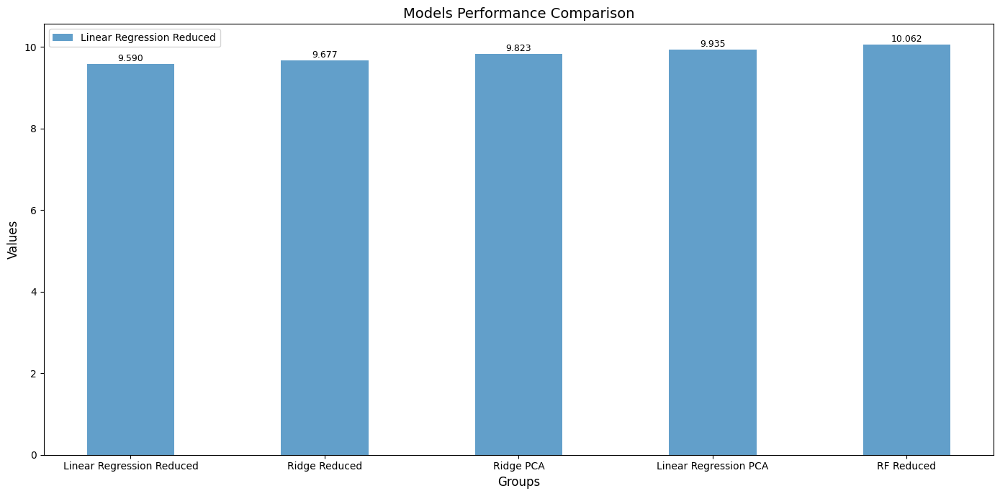

In [443]:
results = sorted_results["Result"].values
labels = sorted_results["Model"].values
plot_model_scores(results, labels=labels, group_names=labels)
